#  Create AGB model Jan reduction images
---

The original model contains more points than we need (see e.g. [De Ceuster et al. 2020](https://arxiv.org/abs/2011.14998)). Therfore we will try to reduce it.

## Imports

In [1]:
import yt
import vtk
import h5py
import meshio
import numpy           as np
import magritte.setup  as setup
import magritte.mesher as mesher
import magritte.core   as magritte

from tqdm                   import tqdm
from astropy                import constants
from vtk.util.numpy_support import vtk_to_numpy
from scipy.spatial          import Delaunay, cKDTree
from numba                  import njit
from yt.funcs               import mylog
mylog.setLevel(40) # This sets the log level to "ERROR"

/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:666: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  self[key]


In [2]:
import os
import sys

# curdir = os.path.dirname(os.path.realpath(__file__))
curdir = os.getcwd()
print(curdir)
prefix='../../models/'

/home/thomas/github/Magritte/tests/benchmarks/numeric


## Reduce mesh

In [140]:
# with h5py.File(prefix+'model_Jan.hdf5') as file:
#     pos = np.array(file['geometry/points/position'        ], dtype = np.float64)
#     nbs = np.array(file['geometry/points/neighbors'       ], dtype = np.int64  )
#     nns = np.array(file['geometry/points/n_neighbors'     ], dtype = np.int64  )
#     bdy = np.array(file['geometry/boundary/boundary2point'], dtype = np.int64  )
#     nCO = np.array(file['chemistry/species/abundance'     ], dtype = np.float64)[:,1]

In [141]:
# delaunay = Delaunay(pos)

In [142]:
# @njit
# def get_pfs (nns):
#     pfs = np.zeros(nns.shape, dtype=np.int64)
#     tot = 0
#     for i, n in enumerate(nns):
#         tot    += n
#         pfs[i]  = tot
#     return pfs
        
# @njit
# def get_nbs (nbs, pfs, i):
#     if (i == 0):
#         return nbs[0:pfs[0]]
#     else:
#         return nbs[pfs[i-1]:pfs[i]]

# @njit
# def norm (vec_arr):
#     norms = np.zeros(vec_arr.shape[0])
#     for i in range(vec_arr.shape[0]):
#         for j in range(vec_arr.shape[1]):
#             norms[i] = norms[i] + vec_arr[i,j]**2
#     return np.sqrt(norms)

# @njit
# def get_Gs (tracer, nbs, pfs):
#     Gs = np.zeros(tracer.shape[0])
#     for i in range(tracer.shape[0]):
#         tracer_i = tracer[i]
#         tracer_n = tracer[get_nbs(nbs, pfs, i)]
#         Gs[i] = np.max(np.abs(tracer_i - tracer_n) / (tracer_i + tracer_n))
#     return Gs
        
# @njit
# def get_Ls (pos, nbs, pfs):
#     Ls = np.zeros(pos.shape[0])
#     for i in range(pos.shape[0]):
#         Ls[i] = np.mean(norm(pos[i] - pos[get_nbs(nbs, pfs, i)]))
#     return Ls

# @njit
# def get_weight (pos, nbs, nns, tracer, threshold=0.21, fmin=1.0, ftarget=2.15):

#     pfs = get_pfs (nns)
#     GGs = get_Gs  (tracer, nbs, pfs)
#     LLs = get_Ls  (pos,    nbs, pfs)
    
#     L_min    = fmin    * LLs
#     L_target = ftarget * LLs
    
#     weight = L_target
#     weight[GGs > threshold] = L_min[GGs > threshold]

#     return weight


# # Define an outer boundary for the model
# bound = 0.99 * np.min(np.linalg.norm(pos[bdy], axis=1))

In [143]:
# meshName  = 'model_Jan_reduced'
# scale_max = 1.0e+99
# scale_min = 0.0
# threshold = 0.21
# fmin      = 1.0       # don't allow refinenment 
# ftarget   = 2.15      # approx 10^(-1/3) for approx 10 times fewer points 

# # Create a background mesh (in .mesh format)
# meshio.write_points_cells(
#     filename   = f'{meshName}.msh',
#     points     =             delaunay.points,
#     cells      = {'tetra'  : delaunay.simplices},
#     point_data = {'weights': get_weight(pos=pos, nbs=nbs, nns=nns, tracer=nCO, threshold=threshold, fmin=fmin, ftarget=ftarget)}
# )

# # Convert .msh to .pos mesh for Gmsh
# mesher.convert_msh_to_pos (meshName=meshName, replace=True)

# # Create a new mesh from the background mesh
# mesher.create_mesh_from_background(
#     meshName  = meshName,
#     boundary  = mesher.boundary_sphere(radius=bound),
#     scale_min = scale_min,
#     scale_max = scale_max
# )

## Create a reduced Magritte model

In [144]:
#vtk_file   = prefix+'model_Jan_reduced.vtk'
#model_file = prefix+'model_Jan_reduced.hdf5'
# lamda_file = prefix+'../data/co.txt'

# vtk_file   = prefix+'vanZadelhoff_1_3D_mesher.vtk'
# model_file = prefix+'vanZadelhoff_1a_3D_mesher.hdf5'

In [145]:
# Load the mesh created above
#mesh = mesher.Mesh(vtk_file)

# # Set model parameters
# dimension = 3
# npoints   = mesh.points.shape[0]
# nrays     = 12*1*1
# nspecs    = 5
# nlspecs   = 1
# nquads    = 5 # minimum recommended by frederik
# # nquads    = 1 #for testing where errors lie, the lower the better

# # "Interpolate" (effectively just map the points)
# corresp_points = cKDTree(pos).query(mesh.points)[1]

# # Load original model
# model = magritte.Model('model_Jan.hdf5')

# # Map data
# position = np.array(model.geometry.points.position        )[corresp_points]
# velocity = np.array(model.geometry.points.velocity        )[corresp_points]
# nCO      = np.array(model.chemistry.species.abundance     )[corresp_points,1]
# nH2      = np.array(model.chemistry.species.abundance     )[corresp_points,2]
# tmp      = np.array(model.thermodynamics.temperature.gas  )[corresp_points]
# trb      = np.array(model.thermodynamics.turbulence.vturb2)[corresp_points]

# # Extract Delaunay vertices (= Voronoi neighbors)
# delaunay = Delaunay(position)
# (indptr, indices) = delaunay.vertex_neighbor_vertices
# neighbors = [indices[indptr[k]:indptr[k+1]] for k in range(npoints)]
# nbs       = [n for sublist in neighbors for n in sublist]
# n_nbs     = [len(sublist) for sublist in neighbors]

# # Convenience arrays
# zeros = np.zeros(npoints)
# ones  = np.ones (npoints)

In [146]:
# model = magritte.Model ()
# model.parameters.set_spherical_symmetry(False)
# model.parameters.set_pop_prec          (1.0e-6)
# model.parameters.set_model_name        (model_file)
# model.parameters.set_dimension         (dimension)
# model.parameters.set_npoints           (npoints)
# model.parameters.set_nrays             (nrays)
# model.parameters.set_nspecs            (nspecs)
# model.parameters.set_nlspecs           (nlspecs)
# model.parameters.set_nquads            (nquads)

# model.geometry.points.position.set(position)
# model.geometry.points.velocity.set(velocity)

# #model.geometry.points.  neighbors.set(  nbs)
# #model.geometry.points.n_neighbors.set(n_nbs)
# model.geometry.points.multiscale.set_all_neighbors(n_nbs,nbs)

# model.chemistry.species.abundance = np.array((zeros, nCO, nH2, zeros, ones)).T
# model.chemistry.species.symbol    = ['dummy0', 'CO', 'H2', 'e-', 'dummy1']

# model.thermodynamics.temperature.gas  .set(tmp)
# model.thermodynamics.turbulence.vturb2.set(trb)

# model.parameters.set_nboundary(len(mesh.boundary))
# model.geometry.boundary.boundary2point.set(mesh.boundary)

# model = setup.set_boundary_condition_CMB  (model)
# model = setup.set_uniform_rays            (model)
# model = setup.set_linedata_from_LAMDA_file(model, lamda_file)
# model = setup.set_quadrature              (model)

# model.write()

In [16]:
# modelFile = prefix+'model_Jan_reduced_naive_multigrid_1lvl_04coars.hdf5'
modelFile = prefix+'vanZadelhoff_1a_3D_mesher_naive_multigrid_1lvl_01coars.hdf5'
model = magritte.Model (modelFile)
coars_tol=0.1#0.4

model.setup_multigrid(1,coars_tol,1,20,0)
coarser_points = np.array(model.geometry.points.multiscale.get_current_points_in_grid())
positions=np.array(model.geometry.points.position)
rs   = np.linalg.norm(np.array(model.geometry.points.position), axis=1)
neighbors=np.array(model.geometry.points.multiscale.neighbors)
abundance=np.array(model.chemistry.species.abundance)[:,1]

In [17]:
#for model_jan_reduced, it is possible that some points have no neighbors, so needs a slight workaround for plotting
print(neighbors)
print(len(neighbors[0]))
nb_neighbors_coarser_points=np.zeros(len(coarser_points))
idx=0
for point in coarser_points:
    nb_neighbors_coarser_points[idx]=len(neighbors[0][point])
    idx+=1
    

# true_coarser_points=coarser_points[nb_neighbors_coarser_points>0]
true_coarser_points=coarser_points
print(true_coarser_points)
print(len(true_coarser_points))
print(len(coarser_points))

[[{5890, 6626, 260, 56677, 107556, 135, 60967, 12, 4438, 2943, 31928, 383}
  {3680, 4416, 259, 88355, 136, 42, 43, 100919, 1466, 2942, 48063}
  {51808, 321, 322, 103424, 73, 74, 1488, 2224, 3698, 5175} ...
  {40320, 24234, 73036, 78284, 92703, 56271, 15215, 67830, 67864, 44095}
  {30241, 91811, 112196, 65095, 12651, 60686, 94959, 51059, 44468, 94555, 52220, 20638, 34367}
  {78148, 89253, 55718, 32424, 49673, 64682, 98125, 39662, 111406, 54932, 13269, 98709, 23191, 78457}]
 [{5890, 6626, 260, 70308, 107556, 135, 12, 4438, 2943, 383}
  {3680, 4416, 259, 98183, 136, 42, 43, 96589, 100919, 1466, 2942}
  {321, 322, 3686, 73, 74, 1931, 5162, 17643, 29069, 98505, 1488, 2224, 3698, 62547, 101110, 5175}
  ... set() set() set()]]
112938
[     0      1      2 ... 112930 112933 112934]
51841
51841


In [18]:
mesh=Delaunay(positions[true_coarser_points])
fullmesh=Delaunay(positions)

In [19]:
print(mesh.simplices)
print(len(mesh.points))

[[13952 48180 17728 28317]
 [13952 48180 27958 28317]
 [16589 26327 44211 17503]
 ...
 [ 6140  6039  6037  6038]
 [ 6140  6303  6582  6301]
 [ 6140  6303  6301  6302]]
51841


In [20]:
def calc_dist(p1,p2):
    return np.sqrt(np.sum(np.square(positions[p1,:]-positions[p2,:])))

In [21]:
# print(neighbors_finer_grid[coarser_points][3])
# print(coarser_points[3])
# print(np.array(model.geometry.points.multiscale.neighbors)[0])
# print(len(np.array(model.geometry.points.multiscale.neighbors)[0]))
# print(np.array(model.geometry.points.multiscale.neighbors)[0][3])

In [22]:
# average_dist_original=np.zeros(model.parameters.npoints())
# average_dist_coarsened=np.zeros(model.parameters.npoints())
average_dist_original=np.zeros(len(true_coarser_points))
average_dist_coarsened=np.zeros(len(true_coarser_points))
neighbors_coarser_grid=np.array(model.geometry.points.multiscale.neighbors)[1]
neighbors_finer_grid=np.array(model.geometry.points.multiscale.neighbors)[0]
point_idx=0
for coarser_point in true_coarser_points:
    temp_dist=0
    temp_idx=0
    for orig_nb in neighbors_finer_grid[coarser_point]:
        temp_dist+=calc_dist(coarser_point,orig_nb)
        temp_idx+=1
#     print(temp_idx)
    try:
        average_dist_original[point_idx]=temp_dist/temp_idx
    except ZeroDivisionError:#for some reason, the point in the grid does not have neighbors???
        average_dist_original[point_idx]=0
    temp_dist=0
    temp_idx=0
    for coars_nb in neighbors_coarser_grid[coarser_point]:
        temp_dist+=calc_dist(coarser_point,coars_nb)
        temp_idx+=1
    try:
        average_dist_coarsened[point_idx]=temp_dist/temp_idx 
    except ZeroDivisionError:#for some reason, the point in the grid does not have neighbors???
        average_dist_coarsened[point_idx]=0
    
    point_idx+=1
    

In [23]:
print(len(average_dist_original))
print(len(average_dist_coarsened))
print(average_dist_original)
print(average_dist_coarsened)
rel_diff_average_dist=np.abs(average_dist_original-average_dist_coarsened)/average_dist_original
print(rel_diff_average_dist)
print(len(rel_diff_average_dist))
print(positions[true_coarser_points[rel_diff_average_dist==0]])



51841
51841
[5.38648731e+11 5.17846306e+11 4.39382700e+11 ... 2.33755610e+15
 2.11166841e+15 2.64541841e+15]
[5.12182097e+11 5.48673488e+11 6.99500638e+11 ... 3.48000830e+15
 2.01700941e+15 3.96923397e+15]
[0.04913524 0.0595296  0.59200769 ... 0.48873788 0.04482664 0.50041821]
51841
[[ 0.00000000e+00  0.00000000e+00  7.80000000e+16]
 [ 4.27555095e+12 -9.03989293e+12  0.00000000e+00]
 [ 0.00000000e+00 -5.55570234e+12 -8.31469611e+12]
 ...
 [ 8.84714721e+12 -3.87488046e+13 -3.56538811e+13]
 [ 1.84218405e+13 -5.20146924e+13 -4.33612822e+13]
 [-1.09457636e+12  2.29739799e+13 -1.99044254e+13]]


In [24]:
# zeromesh=Delaunay(positions[coarser_points[rel_diff_average_dist==0]])
# nonzeromesh=Delaunay(positions[coarser_points[rel_diff_average_dist!=0]])

In [156]:
# quantity = 'n_mol'
# quantity = 'level 0 relative levelpopulations'
quantity = 'relative diff distance'
# quantity = 'relative diff levelpops'
# print(mesh.tetras.astype(np.int64)[coarser_points])
# print(mesh.tetras.astype(np.int64))
# print(mesh.points.astype(np.float64)[coarser_points])

ds = yt.load_unstructured_mesh(
         connectivity = fullmesh.simplices.astype(np.int64),
         coordinates  = fullmesh.points.astype(np.float64),
         node_data    = {('connect1', quantity): rel_diff_average_dist[fullmesh.simplices].astype(np.float64)}
)

sl = yt.SlicePlot(ds, 'z', quantity)
sl.set_log             (quantity, True)
sl.set_cmap            (quantity, 'magma')
sl.zoom                (1)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.2]})

IndexError: index 74614 is out of bounds for axis 0 with size 51841

In [30]:
# final_file=h5py.File(prefix+'model_Jan_reduced_naive_multigrid_1lvl_04coars.hdf5')
final_file=h5py.File(prefix+'vanZadelhoff_1a_3D_mesher_naive_multigrid_1lvl_01coars.hdf5')
(i,ra,rb,nh,tk,nm,vr,db,td,lp0,lp1) = np.loadtxt (f'{curdir}/Ratran_results/vanZadelhoff_1a.out', skiprows=14, unpack=True)

from scipy.interpolate import interp1d
interp_0 = interp1d(0.5*(ra+rb), lp0, fill_value='extrapolate')
print(interp_0)#interpolation function for the reference values
distance_from_origin=np.array([np.sqrt(np.sum(np.square(pos))) for pos in positions])
print(len(distance_from_origin))
print(min(distance_from_origin))
print(max(distance_from_origin))
print(len(rs))
print(min(rs))
print(max(rs))
print(max(rs-distance_from_origin))


level=0
final_it_coarsest=19#6#135#19
final_it_finest=3#5#33#3

final_levelpops=np.array(final_file[f'lines/lineProducingSpecies_0/populationlvl0it{final_it_finest}'])
level0levelpops=final_levelpops[coarser_points,level]
coarse_levelpops=np.array(final_file[f'lines/lineProducingSpecies_0/populationlvl1it{final_it_coarsest}'])
coarselevel0levelpops=coarse_levelpops[coarser_points,level]
# abundance=np.array(model.chemistry.species.abundance)[:,1]
print(len(level0levelpops))
# print(len(abundance))
relative_diff_levelpops=np.abs(level0levelpops-coarselevel0levelpops)/level0levelpops
print(relative_diff_levelpops)
print(len(final_levelpops))


rel_diff_fine_analytic=np.abs(interp_0(distance_from_origin)-final_levelpops[:,level]/abundance)/interp_0(distance_from_origin)
print(rel_diff_fine_analytic)
print(interp_0(distance_from_origin))
print(min(rel_diff_fine_analytic))
print(max(rel_diff_fine_analytic))

rel_diff_coarse_analytic=(np.abs(interp_0(distance_from_origin)-coarse_levelpops[:,0]/abundance)/interp_0(distance_from_origin))[coarser_points]
print(rel_diff_coarse_analytic)
print(min(rel_diff_coarse_analytic))
print(max(rel_diff_coarse_analytic))

112938
9999999999999.996
7.800000000000003e+16
112938
9999999999999.996
7.800000000000003e+16
0.0
51841
[7.14659025e-04 8.71872234e-04 8.37522450e-04 ... 2.22354666e-07
 2.03946355e-07 6.93549322e-08]
112938
[2.10795434e-01 2.10429251e-01 2.12588082e-01 ... 7.43484304e-05
 7.19741679e-05 7.23157074e-05]
[0.28256368 0.28256368 0.28256368 ... 0.88789587 0.88789116 0.88789122]
4.4575513661901226e-08
0.2133307570665738
[2.11660740e-01 2.11484591e-01 2.13603652e-01 ... 6.71837680e-05
 2.68731989e-03 6.85680274e-05]
3.845966449482287e-09
0.21521488963641924


In [31]:
#interpolating the levelpops on the coarser grid
model.restart_from_iteration(final_it_coarsest,1)
model.interpolate_levelpops_local(1)
nlev=2
pops_interpolated = np.array(model.lines.lineProducingSpecies[0].population).reshape((model.parameters.npoints(), nlev))
rel_diff_interp_analytic=np.abs(interp_0(distance_from_origin)-pops_interpolated[:,level]/abundance)/interp_0(distance_from_origin)
print(len(pops_interpolated))

112938


In [32]:
relative_diff_levelpops_interp=np.abs(final_levelpops[:,level]-pops_interpolated[:,level])/final_levelpops[:,level]
print(relative_diff_levelpops_interp)
print(len(relative_diff_levelpops_interp))
print(len(final_levelpops[:,level]))
print(len(pops_interpolated[:,level]))
print(len(rel_diff_interp_analytic))
print(rel_diff_interp_analytic)

[7.14659025e-04 8.71872234e-04 8.37522450e-04 ... 1.33635895e-07
 1.83612237e-07 1.51944391e-06]
112938
112938
112938
112938
[2.11660740e-01 2.11484591e-01 2.13603652e-01 ... 7.42148045e-05
 7.21577669e-05 7.07963733e-05]


/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
  self[key] = other[key]
/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]



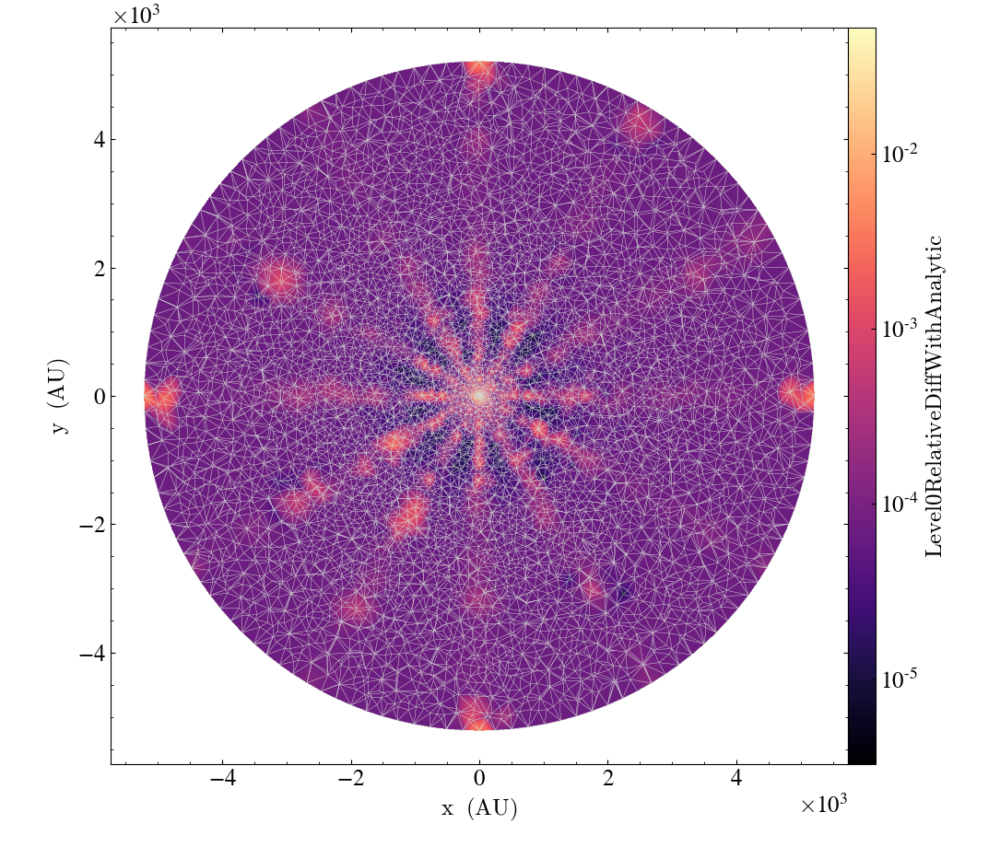

In [34]:
# quantity = 'n_mol'
# quantity = 'level 0 relative levelpopulations'
quantity = 'level 0 relative diff with analytic'
# quantity = 'relative diff distance'
# quantity = 'relative diff levelpops'
# print(mesh.tetras.astype(np.int64)[coarser_points])
# print(mesh.tetras.astype(np.int64))
# print(mesh.points.astype(np.float64)[coarser_points])

ds = yt.load_unstructured_mesh(
         connectivity = fullmesh.simplices.astype(np.int64),
         coordinates  = fullmesh.points.astype(np.float64),
#          node_data    = {('connect1', quantity): rel_diff_average_dist[mesh.simplices].astype(np.float64)}
#          node_data    = {('connect1', quantity): relative_diff_levelpops_interp[fullmesh.simplices].astype(np.float64)}
#          node_data    = {('connect1', quantity): final_levelpops[fullmesh.simplices,1]/abundance[fullmesh.simplices].astype(np.float64)}
#          node_data    = {('connect1', quantity): rel_diff_fine_analytic[fullmesh.simplices].astype(np.float64)}
         node_data    = {('connect1', quantity): rel_diff_interp_analytic[fullmesh.simplices].astype(np.float64)}
)


sl = yt.SlicePlot(ds, 'z', quantity)
sl.set_log             (quantity, True)
sl.set_cmap            (quantity, 'magma')
sl.zoom                (1)
# sl.set_zlim(field=quantity, zmin=1e-6, zmax=1e-3)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.2]})

As we can see, this model contains far fewer points.

In [111]:
model.parameters.npoints()

30485

/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]
/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
  self[key] = other[key]
/home/thomas/anaconda3/envs/magritte/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  self[key] = other[key]



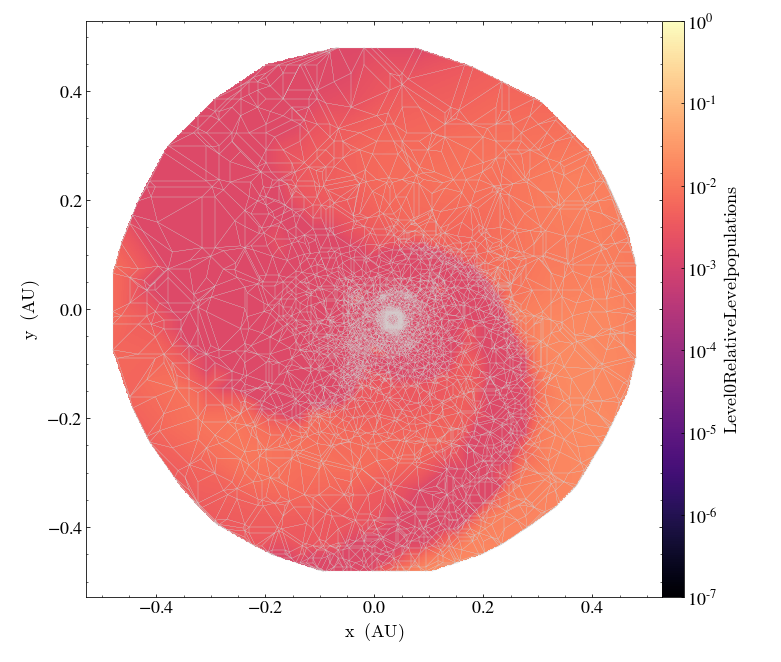

In [388]:
# quantity = 'n_mol'
quantity = 'level 0 relative levelpopulations'
# quantity = 'relative diff distance'
# quantity = 'relative diff levelpops'
# print(mesh.tetras.astype(np.int64)[coarser_points])
# print(mesh.tetras.astype(np.int64))
# print(mesh.points.astype(np.float64)[coarser_points])

# ds = yt.load_unstructured_mesh(
#          connectivity = mesh.simplices.astype(np.int64),
#          coordinates  = mesh.points.astype(np.float64),
#          node_data    = {('connect1', quantity): relative_diff_levelpops[mesh.simplices].astype(np.float64)}
# )

ds = yt.load_unstructured_mesh(
         connectivity = fullmesh.simplices.astype(np.int64),
         coordinates  = fullmesh.points.astype(np.float64),
         node_data    = {('connect1', quantity): (final_levelpops[fullmesh.simplices,0]/abundance[fullmesh.simplices]).astype(np.float64)}
)

sl = yt.SlicePlot(ds, 'z', quantity)
sl.set_log             (quantity, True)
sl.set_cmap            (quantity, 'magma')
sl.zoom                (1)
# sl.set_zlim(field=quantity, zmin=10e-14, zmax=1000)
sl.set_zlim(field=quantity, zmin=10e-8, zmax=1)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.2]})

In [80]:
from matplotlib.animation import FuncAnimation
from matplotlib import rc_context

# quantity = 'relative diff levelpops'
quantity = 'relative levelpops'


# ds = yt.load_unstructured_mesh(
#          connectivity = mesh.simplices.astype(np.int64),
#          coordinates  = mesh.points.astype(np.float64),
#          node_data    = {('connect1', quantity): relative_diff_levelpops[mesh.simplices].astype(np.float64)}
# )

ds = yt.load_unstructured_mesh(
         connectivity = fullmesh.simplices.astype(np.int64),
         coordinates  = fullmesh.points.astype(np.float64),
         node_data    = {('connect1', quantity): (final_levelpops[fullmesh.simplices,0]/abundance[fullmesh.simplices]).astype(np.float64)}
)

sl = yt.SlicePlot(ds, 'z', quantity)
sl.set_log             (quantity, True)
sl.set_cmap            (quantity, 'magma')
sl.zoom                (1)
sl.annotate_mesh_lines (plot_args={'color':'lightgrey', 'linewidths':[.2]})

fig = sl.plots[quantity].figure



In [81]:
#calculate relative differences for all levels

all_levels_rel_diffs=np.zeros(41*16019).reshape(41,16019)

for level in range(41):
    final_levelpops=np.array(final_file['lines/lineProducingSpecies_0/populationlvl0it5'])
    level0levelpops=final_levelpops[coarser_points,level]
    coarse_levelpops=np.array(final_file['lines/lineProducingSpecies_0/populationlvl1it6'])
    coarselevel0levelpops=coarse_levelpops[coarser_points,level]

    relative_diff_pops=np.abs(level0levelpops-coarselevel0levelpops)/level0levelpops

    all_levels_rel_diffs[level,:]=relative_diff_pops

In [82]:
#calculate relative differences for all levels
#parameters.npoints()
all_levels_rel_diffs=np.zeros(41*30485).reshape(41,30485)

for level in range(41):
    final_levelpops=np.array(final_file['lines/lineProducingSpecies_0/populationlvl0it5'])
    level0levelpops=final_levelpops[:,level]
    coarse_levelpops=np.array(final_file['lines/lineProducingSpecies_0/populationlvl1it6'])
    coarselevel0levelpops=pops_interpolated[:,level]

    relative_diff_pops=np.abs(level0levelpops-coarselevel0levelpops)/level0levelpops

    all_levels_rel_diffs[level,:]=relative_diff_pops

In [83]:
print(all_levels_rel_diffs)
print(len(all_levels_rel_diffs))
print(all_levels_rel_diffs[0,:])

print(all_levels_rel_diffs[0,mesh.simplices])

slices=np.array(all_levels_rel_diffs[0,mesh.simplices])
for level in range(40):
    slices=np.dstack([slices,all_levels_rel_diffs[level+1,mesh.simplices]])

[[5.05219250e-02 2.70360392e-08 9.51817733e-05 ... 7.89377803e-03
  9.90572382e-13 3.02036622e-01]
 [5.05669923e-02 2.70541842e-08 9.51484024e-05 ... 1.39199951e-02
  4.90305047e-13 3.01079142e-01]
 [5.07820553e-02 2.78202210e-08 9.50451144e-05 ... 2.48436048e-02
  1.02716612e-12 2.99150686e-01]
 ...
 [9.99986474e-01 2.15948384e-06 4.52435919e-02 ... 1.38194604e-01
  2.53017329e-11 2.32189331e+00]
 [9.99990915e-01 2.82920480e-06 5.02686427e-02 ... 1.37119539e-01
  3.97885627e-11 2.67821044e+00]
 [9.99994472e-01 4.45705289e-06 5.87094979e-02 ... 1.34075551e-01
  5.38627053e-11 3.08082007e+00]]
41
[5.05219250e-02 2.70360392e-08 9.51817733e-05 ... 7.89377803e-03
 9.90572382e-13 3.02036622e-01]
[[4.00318648e-05 8.28470063e-05 3.50673521e-05 2.21119959e-01]
 [1.75050628e-05 2.54168918e-05 1.50192686e-04 7.55839902e-06]
 [7.32726552e-04 4.14593896e-03 1.17924107e-04 1.20884430e-03]
 ...
 [2.36627529e-02 2.76803532e-05 2.12640321e+00 6.83135201e-14]
 [2.36627529e-02 3.87557404e-01 5.72327366e

In [92]:
datastructures=[None] * 41
for level in range(41):
    datastructures[level] = yt.load_unstructured_mesh(
         connectivity = fullmesh.simplices.astype(np.int64),
         coordinates  = fullmesh.points.astype(np.float64),
         node_data    = {('connect1', quantity): all_levels_rel_diffs[level,fullmesh.simplices].astype(np.float64)}
    )
    
levelpopsdatastructures=[None]*41
for level in range(41):
    levelpopsdatastructures[level] = yt.load_unstructured_mesh(
         connectivity = mesh.simplices.astype(np.int64),
         coordinates  = mesh.points.astype(np.float64),
         node_data    = {('connect1', quantity): (final_levelpops[mesh.simplices,level]/abundance[mesh.simplices]).astype(np.float64)}
    )

In [93]:
def animate(level):
#     print(slices[level,:,:])
#     print(level)
#     ds = yt.load_unstructured_mesh(
#          connectivity = mesh.simplices.astype(np.int64),
#          coordinates  = mesh.points.astype(np.float64),
#          node_data    = {('connect1', quantity): relative_diff_levelpops[mesh.simplices].astype(np.float64)}
#     )
    

#     sl = yt.SlicePlot(ds, 'z', quantity)
    sl.annotate_title('Relative difference for population level: '+str(level))
#     sl.display()
    sl._switch_ds(datastructures[level])
    sl.set_zlim(field=quantity, zmin=10e-14, zmax=1000)
    
def animate_levelpops(level):
    sl.annotate_title('Relative levelpops for population level: '+str(level))
    sl._switch_ds(levelpopsdatastructures[level])
    sl.set_zlim(field=quantity, zmin=10e-8, zmax=1)
    
anim = FuncAnimation(fig, animate, frames=range(41))
anim2 =FuncAnimation(fig, animate_levelpops, frames=range(41))

In [94]:
import os
cwd = os.getcwd()
print(cwd)
# import networkx as nx
from matplotlib.animation import FuncAnimation, PillowWriter

%matplotlib notebook
anim

/home/thomas/github/Magritte/tests/benchmarks/numeric


In [95]:
from IPython.display import HTML
HTML(anim.to_jshtml())

/home/thomas/anaconda3/envs/magritte/lib/python3.7/site-packages/yt/visualization/base_plot_types.py:258: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  interpolation='nearest', transform=transform)
Animation size has reached 21680917 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [97]:
with rc_context({'mathtext.fontset': 'stix'}):
    anim.save('animation3.mp4', fps=4)

/home/thomas/anaconda3/envs/magritte/lib/python3.7/site-packages/yt/visualization/base_plot_types.py:258: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  interpolation='nearest', transform=transform)
